# **EXTEND PRE TRAINED YOLOv3 OBJECT DETECTION MODEL WITH TRANSFER LEARNING**

**In google colab , click on runtime -> change runtime type and then set Hardware accelerator to GPU before proceeding**

**Mount drive , that is connect your google drive with this notebook**

In [ ]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


**create a folder called Kang in your drive before continuing.  all files will be stored in drive->Mydrive->Kang**

In [ ]:
%cd /content/drive/MyDrive/Kang

/content/drive/MyDrive/Kang


**Clone the repository which contains the files related to the yolov3 model**

In [ ]:
!git clone https://github.com/roboflow-ai/keras-yolo3

Cloning into 'keras-yolo3'...
remote: Enumerating objects: 169, done.
remote: Total 169 (delta 0), reused 0 (delta 0), pack-reused 169
Receiving objects: 100% (169/169), 172.74 KiB | 2.24 MiB/s, done.
Resolving deltas: 100% (80/80), done.


In [ ]:
%cd /content/drive/MyDrive/Kang/keras-yolo3

/content/drive/MyDrive/Kang/keras-yolo3


**download pre trained yolov3 weights**

In [ ]:
!wget https://pjreddie.com/media/files/yolov3.weights

--2023-07-06 09:33:38--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights’

yolov3.weights      100%[===================>] 236.52M  56.1MB/s    in 4.5s    

2023-07-06 09:33:42 (52.6 MB/s) - ‘yolov3.weights’ saved [248007048/248007048]



# **Converting the weights file format by running convert.py**

Steps to follow before executing the following cells:

*   go to the convert.py file present in Kang -> keras-yolov3 folder
*   change lines 17 from -> from keras.layers.advanced_activations import LeakyReLU **to** from keras.layers import LeakyReLU.
Similarily change line 18 from -> from keras.layers.normalization import BatchNormalization **to** from keras.layers import BatchNormalization


*   Run the following cells









In [ ]:
!python convert.py yolov3.cfg yolov3.weights model_data/yolo.h5

2023-07-06 09:34:14.275383: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-06 09:34:15.159174: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Loading weights.
Weights Header:  0 2 0 [32013312]
Parsing Darknet config.
Creating Keras model.
Parsing section net_0
Parsing section convolutional_0
conv2d bn leaky (3, 3, 3, 32)
2023-07-06 09:34:16.728990: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-07-06 09:34:17.288249: I tensorflow/co

# **Loading pre trained YOLOv3 trained on COCO (80 classes)**

In [ ]:
from tensorflow import keras

In [ ]:
model = keras.models.load_model('/content/drive/MyDrive/Kang/keras-yolo3/model_data/yolo.h5')

**plot the yolov3 architecture to understand it better**

In [ ]:
from keras.utils.vis_utils import plot_model

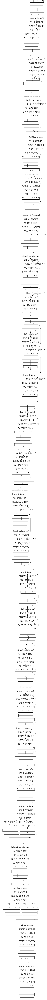

In [ ]:
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

# **EXPLAINATION OF YOLOv3 ARCHITECTURE**



*   Yolov3 contains 3 final prediction layers conv2d_74 ,conv2d_66,conv2d_58 . each of these 3 final layers predicts 3 final bounding boxes .
*   there are 255 nodes in each of the final layers , since each layer predicts 3 final bounding boxes , 255/3 = 85 nodes for each bounding box


*   the 85 nodes represent : 1 for if there is any object or not , 4 for the coordinates of the bounding box on the image , 80 for the 80 classes of coco


*   and this 85 nodes setup repeats 3 times to make the 255 nodes in each of the final layers
*   remember this architecture as it will be needed to manipulate the layers later on







# **Modifying the 3 , output layers (extending for one more class)**

since we are extending for 1 class , and we know that in each final layer there are 3 sets of bounding boxes , so 3 times the 80 classes of coco nodes are there so we have to extend for each of the 3 sets by 1 . so total final count of nodes in final layer must be 255 + 3 = 258

**FOR FINAL LAYER 1 :**

In [ ]:
#removing conv2d_74

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense

# Get the second last layer of the model
second_last_layer = model.get_layer('leaky_re_lu_71')
last_layer_2 = model.get_layer('conv2d_66')
last_layer_3 = model.get_layer('conv2d_58')

# Remove the last layer
model = Model(inputs=model.input, outputs=[second_last_layer.output,last_layer_2.output,last_layer_3.output])

In [ ]:
#adding a new conv2d layer of 258 nodes
import tensorflow as tf

# Set the output of the model
last_layer_2 = model.get_layer('conv2d_66')
last_layer_3 = model.get_layer('conv2d_58')
model.outputs = [model.get_layer('leaky_re_lu_71').output]

from tensorflow.keras.layers import Conv2D

new_conv_layer = Conv2D(258, (1, 1), padding='same', activation='relu',name='conv2d_new1')
output = new_conv_layer(model.outputs[0])
output =[output,last_layer_2.output,last_layer_3.output]

# Create the new model with the updated architecture
model2 = tf.keras.models.Model(inputs=model.inputs, outputs=output)

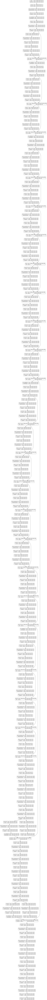

In [ ]:
plot_model(model2, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

**FOR FINAL LAYER 2:**

In [ ]:
#removing conv2d_66

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense

# Get the second last layer of the model
second_last_layer = model2.get_layer('leaky_re_lu_64')
last_layer_2 = model2.get_layer('conv2d_new1')
last_layer_3 = model2.get_layer('conv2d_58')

# Remove the last layer
model2 = Model(inputs=model2.input, outputs=[second_last_layer.output,last_layer_2.output,last_layer_3.output])

In [ ]:
#adding a new conv2d layer of 258 nodes
import tensorflow as tf

# Set the output of the model
last_layer_2 = model2.get_layer('conv2d_58')
last_layer_3 = model2.get_layer('conv2d_new1')
model.outputs = [model2.get_layer('leaky_re_lu_64').output]

from tensorflow.keras.layers import Conv2D

new_conv_layer = Conv2D(258, (1, 1), padding='same', activation='relu',name='conv2d_new2')
output = new_conv_layer(model.outputs[0])
output =[output,last_layer_2.output,last_layer_3.output]

# Create the new model with the updated architecture
model2 = tf.keras.models.Model(inputs=model2.inputs, outputs=output)

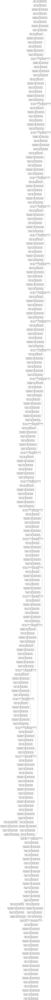

In [ ]:
plot_model(model2, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

**FOR FINAL LAYER 3:**

In [ ]:
#removing conv2d_58

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense

# Get the second last layer of the model
second_last_layer = model2.get_layer('leaky_re_lu_57')
last_layer_2 = model2.get_layer('conv2d_new1')
last_layer_3 = model2.get_layer('conv2d_new2')

# Remove the last layer
model2 = Model(inputs=model2.input, outputs=[second_last_layer.output,last_layer_2.output,last_layer_3.output])

In [ ]:
#adding a new conv2d layer of 258 nodes
import tensorflow as tf

# Set the output of the model
last_layer_2 = model2.get_layer('conv2d_new2')
last_layer_3 = model2.get_layer('conv2d_new1')
model.outputs = [model2.get_layer('leaky_re_lu_57').output]

from tensorflow.keras.layers import Conv2D

new_conv_layer = Conv2D(258, (1, 1), padding='same', activation='relu',name='conv2d_new3')
output = new_conv_layer(model.outputs[0])
output =[output,last_layer_2.output,last_layer_3.output]

# Create the new model with the updated architecture
model3 = tf.keras.models.Model(inputs=model2.inputs, outputs=output)

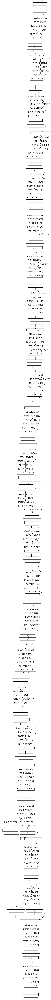

In [ ]:
plot_model(model3, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

------------

# **model3 now has the final architecture we require of 258 nodes on the last layers , we now have to set the weights for these nodes from the pre trained model and custom model**

------------------------

# **Storing the pre trained model weights**

**load the pre trained yolov3 trained on coco dataset and store the weights for the final layers**

In [ ]:
pretrained_model = keras.models.load_model('/content/drive/MyDrive/Kang/keras-yolo3/model_data/yolo.h5')

In [ ]:
pretrained_weights_1=pretrained_model.get_layer("conv2d_74").weights

In [ ]:
pretrained_weights_2=pretrained_model.get_layer("conv2d_66").weights

In [ ]:
pretrained_weights_3=pretrained_model.get_layer("conv2d_58").weights

# **Creating custom model with 81 classes**

**we are going to freeze all the layers of the except the final layers and create a custom model by passing the new kangaroo dataset and coco 128 dataset from roboflow which contains small number of images from coco dataset**

In [ ]:
%cd /content/drive/MyDrive/Kang/keras-yolo3

/content/drive/MyDrive/Kang/keras-yolo3


In [ ]:
%ls

coco_annotation.py  LICENSE              train.py           yolov3.cfg
convert.py          model_data/          Tutorial.ipynb     yolov3-tiny.cfg
darknet53.cfg       model_plot.png       voc_annotation.py  yolov3.weights
font/               README.md            yolo3/             yolo_video.py
kmeans.py           train_bottleneck.py  yolo.py


**downloading kangaroo dataset**



*   Roboflow website gives datasets in various formats that can be downloaded directly into your notebook with a command . you can browse through the website and when you find a dataset to your liking, click on it and then press **download this dataset** button
*  a pop up box called **Export** will open , select format to required format (here we are using yolov3 so change it to **yolov3 keras**)


*   also select the option **show download code** so that we can directly downlaod the dataset into colab without downloading to machine and then uploading . Click on **continue**
*   you will get a code of the following format -> **curl -L "custom-URL" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip .** custom-URL is a long URL that is generated per user .


*   note that if u press the **copy button** and paste here you will get it in a slightly different format which will show **error** if your run  
*   exact Format required  ->   **!curl -L "custom-URL" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip**  . Dont forget the **exclamation mark** symbol in the start.
*   Copy the code into the cell below in correct format and run the following 4 cells one by one







In [ ]:
!curl -L "custom-URL" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   897  100   897    0     0   3297      0 --:--:-- --:--:-- --:--:--  3285
100  245M  100  245M    0     0  82.8M      0  0:00:02  0:00:02 --:--:--  101M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/00017_jpg.rf.28494939e31ecc2e7aa4d9b8d211cc27.jpg  
 extracting: test/00026_jpg.rf.9d735dbae22df0a75a1025de5a6a4a57.jpg  
 extracting: test/00040_jpg.rf.ba432833fbf1656eb0980d6a6550ba67.jpg  
 extracting: test/00046_jpg.rf.dd3e9f6eb7ff54092dcc366f01001e9e.jpg  
 extracting: test/00047_jpg.rf.886de59cc4396a69c8a25c5290c9b0e2.jpg  
 extracting: test/00060_jpg.rf.60517d652ae9069d2fe938e2d6d6afa0.jpg  
 extracting: test/00076_jpg.rf.af263f95e53885b505eda275b7dc6a7c.jpg  
 extracting: test/00100_jpg.rf.04eae57f270be2b54a7df3869c8a6440.jpg  
 extra

**after downloading the kangaroo dataset , dont immediately download the coco 128 dataset , move to cell which has** : %cd /content/drive/MyDrive/Kang/keras-yolo3/train **and then run that cell and its next one which has** %mv * ../* . **after this go to the drive loaction under Kang->keras-yolo3 it should have a file called _annotations.txt . store it somewhere else as annotations_kang ( or download it , your choice but make sure u store it somehwere as annotations_kang)**

**after doing this , run the cell which has : %cd /content/drive/MyDrive/Kang/keras-yolo3 (present up) and then come back to this downloading coco 128 dataset cell and proceed normally**

**downloading coco 128 dataset**

In [ ]:
!curl -L "custom-URL" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   889  100   889    0     0    893      0 --:--:-- --:--:-- --:--:--   892
100 24.8M  100 24.8M    0     0  16.0M      0  0:00:01  0:00:01 --:--:-- 16.0M
Archive:  roboflow.zip
replace README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
 extracting: README.dataset.txt      
replace README.roboflow.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/000000000009_jpg.rf.6acc173402df5523069e146edb03ff4b.jpg  
 extracting: test/000000000025_jpg.rf.ed74f70d3b9ede1832934740b7ac60c7.jpg  
 extracting: test/000000000030_jpg.rf.9b6a40cdb2346d232072517b865b4846.jpg  
 extracting: test/000000000034_jpg.rf.b518abdaed199dcb88854cf20fce8078.jpg  
 extracting: test/000000000036_jpg.rf.236f23e769287f9219fc898a1ab9e716.jpg  
 extracting: test/000000000042_jpg.rf.49cb64

In [ ]:
%cd /content/drive/MyDrive/Kang/keras-yolo3/train

/content/drive/MyDrive/Kang/keras-yolo3/train


In [ ]:
%mv * ../

In [ ]:
%cd ..

/content/drive/MyDrive/Kang/keras-yolo3


In [ ]:
%ls

00002_jpg.rf.b960a79610c80443fb0a4b5ce74aeafe.jpg
00003_jpg.rf.12effdc4de76707f4694ed3f216fbd45.jpg
00006_jpg.rf.a723a682eb1309b59062ea4aee54ee2a.jpg
00009_jpg.rf.dc04e4fc68423226c5c9ca4868c408a2.jpg
00010_jpg.rf.c91bfbb8cb843e8793815cf0d0924ae9.jpg
00012_jpg.rf.37f98b779819fec2368fa0b74822b215.jpg
00013_jpg.rf.67a4585750da615568f81951d2c789f0.jpg
00014_jpg.rf.d42d357502daf4446f3493720457a4c6.jpg
00019_jpg.rf.a4769268770dbbd4ffd752b9b4df99ac.jpg
00021_jpg.rf.d1afa0c63dcbc4c02c50ae0013e5f185.jpg
00022_jpg.rf.50041306ece757161756805b5cedf684.jpg
00023_jpg.rf.907edcd5cad2290208ba736c4a18d384.jpg
00024_jpg.rf.619942f366b3ced23ff8da4f93db0529.jpg
00031_jpg.rf.230a92113fe158b95b26f25f1799cf96.jpg
00032_jpg.rf.0eb70bfe54fd3eaf755a64ac0bd8948f.jpg
00033_jpg.rf.124931ea9c4d71b6d9167619228be32e.jpg
00036_jpg.rf.7e12090130911c43371cd8f801374e09.jpg
00037_jpg.rf.cf049b9d9fdbd265157a0330b869a6b4.jpg
00042_jpg.rf.624ffab09618ecb04f6fb2c946d87253.jpg
00043_jpg.rf.75651a3e13f3d2d537327878707b116f.jpg


-----------------------------

# **MODIFICATIONS TO BE DONE:**



*   in the annotations file which came from installing the kangaroo dataset , the kangaroo class is denoted by index 0 . and same way when we install the coco 128 dataset which does not contain all the classes on COCO (contains 71 last i checked) but their numbering also starts from 0
*  since we are combining both the datasets we have to change the index denotation for the kangaroo class in its annotation file and then copy all the contents from the annotations_kangaroo into the _annotations file which we got when we downloaded the coco 128 dataset. (if the old _annotations from kangaroo dataset was there in the same folder it would have been over written so just open the file to make sure )
*   below is a python script that will add 80 to all locations of class index in the kangaroo_annotations.txt file . so the index of kangaroo class is 80 (as index numbering starts from 0 so 81st class is index 80)
*  after running the below script , we have to now change the _classes.txt file
*  open the _classes.txt file and add : blah1
blah2
blah3
blah4
blah5
blah6
blah7
blah8
blah9
Kangaroo , one after the other line by line to make total 81 classes in out new dataset . note that blah1,blah2,.. so on are just dummy class names ; feel free to add anything but make sure there are 81 classes and kangaroo is the 81st class
*   copy the contents from the **changed annotations_kangaroo.txt**  file , and paste it into the _annotations file present in keras-yolo3 folder
*   after this you can move on to creating the custom model









-----------------------------------------

In [ ]:
input_file = 'path to the annotations_kangaroo.txt file'
output_file = 'output path with new file name eg: /content/new_annotations.txt'


with open(input_file,'r') as f:
    lines=f.readlines()

for line in lines:
    parts=line.split()
    final_line=parts[0]
    for i in range(1,len(parts)):
        subpart=parts[i].split(',')
        subpart[4]=str(int(subpart[4])+80)
        # subpart[4]=str(85)
        final_line=final_line+' '+subpart[0]+','+subpart[1]+','+subpart[2]+','+subpart[3]+','+subpart[4]
    with open(output_file,'a') as f2:
        f2.write(final_line+'\n')
print("done")

---------------------------------------

# **Training the custom model:**

Changes to make in model.py before running the following cell


*   location of file : Kang->keras3->yolo3->model.py
*   change line 9 from from keras.layers.advanced_activations import LeakyReLU **to**  from keras.layers import LeakyReLU . also change line 10 from from keras.layers.normalization import BatchNormalization **to**  from keras.layers import BatchNormalization


*   change line 394 from _, ignore_mask = K.control_flow_ops.while_loop(lambda b,*args: b<m, loop_body, [0, ignore_mask])   **to**     _, ignore_mask = tf.while_loop(lambda b,*args: b<m, loop_body, [0, ignore_mask])
*   you can set the number of epochs and learning rate in the code , here it is set at initial epoch=0 and final epoch=500 with learning rate (lr)=1e-6 .



*  this code freezes all layers of the model except the last 3 final layers and trains the custom model .
*   run the code to create custom model







In case runtime gets disconnected


*   you can go to logs folder and under it go to the lastest epoch .h5 file and in the weights_path paramtere instead of yolo.h5 replace with that epoch .h5 file and change the inital epoch value to the epoch value of the file you are going to use .
*   after doing the above if you run the following cell , it will continue training from where it left off previously , as the logs folder stores all the epoch weights every 3 epochs or so



*   in case you use up all the colab resources for this account , you follow the same procedure in other account with the right epoch to continue training the model from where you left off here





In [ ]:
"""
Self-contained Python script to train YOLOv3 on your own dataset
"""

import numpy as np
import keras.backend as K
from keras.layers import Input, Lambda
from keras.models import Model
from keras.optimizers import Adam
from keras.callbacks import TensorBoard, ModelCheckpoint, ReduceLROnPlateau, EarlyStopping

from yolo3.model import preprocess_true_boxes, yolo_body, tiny_yolo_body, yolo_loss
from yolo3.utils import get_random_data


def _main():
    annotation_path = '_annotations.txt'  # path to Roboflow data annotations
    log_dir = 'logs/000/'                 # where we're storing our logs
    classes_path = '_classes.txt'         # path to Roboflow class names
    anchors_path = 'model_data/yolo_anchors.txt'
    class_names = get_classes(classes_path)
    print("-------------------CLASS NAMES-------------------")
    print(class_names)
    print("-------------------CLASS NAMES-------------------")
    num_classes = len(class_names)
    anchors = get_anchors(anchors_path)

    input_shape = (416,416) # multiple of 32, hw

    is_tiny_version = len(anchors)==6 # default setting
    if is_tiny_version:
        model = create_tiny_model(input_shape, anchors, num_classes,
            freeze_body=2, weights_path='model_data/tiny_yolo_weights.h5')
    else:
        model = create_model(input_shape, anchors, num_classes,
            freeze_body=2, weights_path='model_data/yolo.h5') # make sure you know what you freeze

    logging = TensorBoard(log_dir=log_dir)
    checkpoint = ModelCheckpoint(log_dir + 'ep{epoch:03d}-loss{loss:.3f}-val_loss{val_loss:.3f}.h5',
        monitor='val_loss', save_weights_only=True, save_best_only=True, period=3)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=1)
    early_stopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=1)

    val_split = 0.2 # set the size of the validation set
    with open(annotation_path) as f:
        lines = f.readlines()
    np.random.seed(10101)
    np.random.shuffle(lines)
    np.random.seed(None)
    num_val = int(len(lines)*val_split)
    num_train = len(lines) - num_val

    # Train with frozen layers first, to get a stable loss.
    # Adjust num epochs to your dataset. This step is enough to obtain a not bad model.
    if True:
        model.compile(optimizer=Adam(lr=1e-3), loss={
            # use custom yolo_loss Lambda layer.
            'yolo_loss': lambda y_true, y_pred: y_pred})

        batch_size = 50
        print('Train on {} samples, val on {} samples, with batch size {}.'.format(num_train, num_val, batch_size))
        model.fit_generator(data_generator_wrapper(lines[:num_train], batch_size, input_shape, anchors, num_classes),
                steps_per_epoch=max(1, num_train//batch_size),
                validation_data=data_generator_wrapper(lines[num_train:], batch_size, input_shape, anchors, num_classes),
                validation_steps=max(1, num_val//batch_size),
                epochs=130,
                initial_epoch=0,
                callbacks=[logging, checkpoint])
        model.save_weights(log_dir + 'trained_weights_stage_1.h5')

    # Unfreeze and continue training, to fine-tune.
    # Train longer if the result is not good.
    # if True:
    #     for i in range(len(model.layers)):
    #         model.layers[i].trainable = True
    #     model.compile(optimizer=Adam(lr=1e-4), loss={'yolo_loss': lambda y_true, y_pred: y_pred}) # recompile to apply the change
    #     print('Unfreeze all of the layers.')

    #     batch_size = 32 # note that more GPU memory is required after unfreezing the body
    #     print('Train on {} samples, val on {} samples, with batch size {}.'.format(num_train, num_val, batch_size))
    #     model.fit_generator(data_generator_wrapper(lines[:num_train], batch_size, input_shape, anchors, num_classes),
    #         steps_per_epoch=max(1, num_train//batch_size),
    #         validation_data=data_generator_wrapper(lines[num_train:], batch_size, input_shape, anchors, num_classes),
    #         validation_steps=max(1, num_val//batch_size),
    #         epochs=100,
    #         initial_epoch=50,
    #         callbacks=[logging, checkpoint, reduce_lr, early_stopping])
    #     model.save_weights(log_dir + 'trained_weights_final.h5')

    # Further training if needed.


def get_classes(classes_path):
    '''loads the classes'''
    with open(classes_path) as f:
        class_names = f.readlines()
    class_names = [c.strip() for c in class_names]
    return class_names

def get_anchors(anchors_path):
    '''loads the anchors from a file'''
    with open(anchors_path) as f:
        anchors = f.readline()
    anchors = [float(x) for x in anchors.split(',')]
    return np.array(anchors).reshape(-1, 2)


def create_model(input_shape, anchors, num_classes, load_pretrained=True, freeze_body=2,
            weights_path='model_data/yolo.h5'):
    '''create the training model'''
    K.clear_session() # get a new session
    image_input = Input(shape=(None, None, 3))
    h, w = input_shape
    num_anchors = len(anchors)

    y_true = [Input(shape=(h//{0:32, 1:16, 2:8}[l], w//{0:32, 1:16, 2:8}[l], \
        num_anchors//3, num_classes+5)) for l in range(3)]

    model_body = yolo_body(image_input, num_anchors//3, num_classes)
    print('Create YOLOv3 model with {} anchors and {} classes.'.format(num_anchors, num_classes))

    if load_pretrained:
        model_body.load_weights(weights_path, by_name=True, skip_mismatch=True)
        print('Load weights {}.'.format(weights_path))
        if freeze_body in [1, 2]:
            # Freeze darknet53 body or freeze all but 3 output layers.
            num = (185, len(model_body.layers)-3)[freeze_body-1]
            for i in range(num): model_body.layers[i].trainable = False
            print('Freeze the first {} layers of total {} layers.'.format(num, len(model_body.layers)))

    model_loss = Lambda(yolo_loss, output_shape=(1,), name='yolo_loss',
        arguments={'anchors': anchors, 'num_classes': num_classes, 'ignore_thresh': 0.5})(
        [*model_body.output, *y_true])
    model = Model([model_body.input, *y_true], model_loss)

    return model

def create_tiny_model(input_shape, anchors, num_classes, load_pretrained=True, freeze_body=2,
            weights_path='model_data/tiny_yolo_weights.h5'):
    '''create the training model, for Tiny YOLOv3'''
    K.clear_session() # get a new session
    image_input = Input(shape=(None, None, 3))
    h, w = input_shape
    num_anchors = len(anchors)

    y_true = [Input(shape=(h//{0:32, 1:16}[l], w//{0:32, 1:16}[l], \
        num_anchors//2, num_classes+5)) for l in range(2)]

    model_body = tiny_yolo_body(image_input, num_anchors//2, num_classes)
    print('Create Tiny YOLOv3 model with {} anchors and {} classes.'.format(num_anchors, num_classes))

    if load_pretrained:
        model_body.load_weights(weights_path, by_name=True, skip_mismatch=True)
        print('Load weights {}.'.format(weights_path))
        if freeze_body in [1, 2]:
            # Freeze the darknet body or freeze all but 2 output layers.
            num = (20, len(model_body.layers)-2)[freeze_body-1]
            for i in range(num): model_body.layers[i].trainable = False
            print('Freeze the first {} layers of total {} layers.'.format(num, len(model_body.layers)))

    model_loss = Lambda(yolo_loss, output_shape=(1,), name='yolo_loss',
        arguments={'anchors': anchors, 'num_classes': num_classes, 'ignore_thresh': 0.7})(
        [*model_body.output, *y_true])
    model = Model([model_body.input, *y_true], model_loss)

    return model

def data_generator(annotation_lines, batch_size, input_shape, anchors, num_classes):
    '''data generator for fit_generator'''
    n = len(annotation_lines)
    i = 0
    while True:
        image_data = []
        box_data = []
        for b in range(batch_size):
            if i==0:
                np.random.shuffle(annotation_lines)
            image, box = get_random_data(annotation_lines[i], input_shape, random=True)
            image_data.append(image)
            box_data.append(box)
            i = (i+1) % n
        image_data = np.array(image_data)
        box_data = np.array(box_data)
        y_true = preprocess_true_boxes(box_data, input_shape, anchors, num_classes)
        yield [image_data, *y_true], np.zeros(batch_size)

def data_generator_wrapper(annotation_lines, batch_size, input_shape, anchors, num_classes):
    n = len(annotation_lines)
    if n==0 or batch_size<=0: return None
    return data_generator(annotation_lines, batch_size, input_shape, anchors, num_classes)

if __name__ == '__main__':
    _main()

-------------------CLASS NAMES-------------------
['aeroplane', 'backpack', 'banana', 'baseball bat', 'baseball glove', 'bear', 'bed', 'bench', 'bicycle', 'bird', 'boat', 'book', 'bottle', 'bowl', 'broccoli', 'bus', 'cake', 'car', 'carrot', 'cat', 'cell phone', 'chair', 'clock', 'cup', 'diningtable', 'dog', 'donut', 'elephant', 'fork', 'frisbee', 'giraffe', 'handbag', 'horse', 'hot dog', 'kite', 'knife', 'laptop', 'microwave', 'motorbike', 'mouse', 'orange', 'oven', 'person', 'pizza', 'pottedplant', 'refrigerator', 'remote', 'sandwich', 'scissors', 'sink', 'skateboard', 'skis', 'snowboard', 'sofa', 'spoon', 'sports ball', 'stop sign', 'suitcase', 'teddy bear', 'tennis racket', 'tie', 'toilet', 'toothbrush', 'traffic light', 'train', 'truck', 'tvmonitor', 'umbrella', 'vase', 'wine glass', 'zebra', 'blah1', 'blah2', 'blah3', 'blah4', 'blah5', 'blah6', 'blah7', 'blah8', 'blah9', 'Kangaroo']
-------------------CLASS NAMES-------------------
Create YOLOv3 model with 9 anchors and 81 classes

Load weights model_data/yolo.h5.
Freeze the first 249 layers of total 252 layers.


<ipython-input-30-c8d4eda70c4f>:62: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  model.fit_generator(data_generator_wrapper(lines[:num_train], batch_size, input_shape, anchors, num_classes),


Train on 446 samples, val on 111 samples, with batch size 50.
Epoch 1/130
8/8 [==============================] - 88s 11s/step - loss: 4161.5742 - val_loss: 2075.6843
Epoch 2/130
8/8 [==============================] - 72s 10s/step - loss: 1427.5981 - val_loss: 827.1814
Epoch 3/130
8/8 [==============================] - 75s 10s/step - loss: 626.3163 - val_loss: 416.7502
Epoch 4/130
8/8 [==============================] - 72s 10s/step - loss: 360.2613 - val_loss: 276.4022
Epoch 5/130
8/8 [==============================] - 74s 10s/step - loss: 254.3386 - val_loss: 206.5725
Epoch 6/130
8/8 [==============================] - 70s 10s/step - loss: 203.1968 - val_loss: 166.4796
Epoch 7/130
8/8 [==============================] - 74s 10s/step - loss: 167.3280 - val_loss: 152.8166
Epoch 8/130
8/8 [==============================] - 74s 10s/step - loss: 155.4963 - val_loss: 128.0453
Epoch 9/130
8/8 [==============================] - 77s 11s/step - loss: 136.5714 - val_loss: 131.8202
Epoch 10/130
8/8 

-----------------------------

## **The above code creates a custom model and stores its weights in the final trained_weights_final.h5 file . We now have to load it and save the final model keras model file.**

In [ ]:
from yolo3.model import yolo_body

In [ ]:
class_names = get_classes('/content/drive/MyDrive/Kang/keras-yolo3/_classes.txt')
anchors_path = 'model_data/yolo_anchors.txt'
weights_path = '/content/drive/MyDrive/Kang/keras-yolo3/logs/000/trained_weights_stage_1.h5'
yolo_input_shape = (416, 416)  # Input size of the YOLOv3 model

# Create YOLOv3 model
num_anchors = len(get_anchors(anchors_path))
yolo_model = yolo_body(Input(shape=(None, None, 3)), num_anchors // 3, len(class_names))
yolo_model.load_weights(weights_path)

model_output_path = '/content/drive/MyDrive/Kang/custom_model_comb.h5'
yolo_model.save(model_output_path)

**Loading the custom model**

In [ ]:
custom_model = keras.models.load_model('/content/drive/MyDrive/Kang/custom_model_comb.h5')

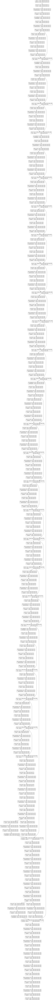

In [ ]:
plot_model(custom_model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

--------------------------

## **Store the custom model weights , it will be used along with the pre trained model weights stored before to create a new set of final weights manually which will set to our final model**

In [ ]:
custom_model_weights1=custom_model.get_layer("conv2d_149").weights
custom_model_weights2=custom_model.get_layer("conv2d_141").weights
custom_model_weights3=custom_model.get_layer("conv2d_133").weights

**note that the custom_model_weights[0].shape and model3.get_layer("conv2d_new1").weights[0].shape must be the same**

In [ ]:
print(pretrained_weights_1[0].shape)
print(custom_model_weights1[0].shape)

(1, 1, 256, 255)
(1, 1, 256, 258)


In [ ]:
print(model3.get_layer("conv2d_new1").weights[0].shape)

(1, 1, 256, 258)


# **Combine weights**

the layers have 2 sets of weights called kernel weights and bias weights .

*   kernel weights are the weights which will be multiplied with the output from the previous layer .
*   bias weights are the ones which will be added to this multiplied value from the previous layer
*   eg: ax+b , where a is output from previosu layer , x is kerbel and b is bias weights
*   weights[0] is the kernel weights and weights[1] is the bias weights for the layers




In [ ]:
import tensorflow as tf

for each of the 3 final layers:
*   we have to take the first 85 nodes from the pre trained model and then add the node of the kangaroo class from the custom model's 1st bounding box nodes, then take next 85 nodes from the pre trained model and then add kangaroo class node from the custom model's 2nd bounding box nodes , and then take the last 85 nodes from the pre trained model and then add the kangaroo class node from the custom model's 3rd bounding box nodes . this will make 258 nodes.
*  we have to do this for both the kernel and well as the bias weights which is what is done below
*   we have to do this for all 3 final layers , which is done below . so continue executing the cells in order





the weights are special array , called tensors here so we have to use the tf.concat to add the weights manually

In [ ]:
final_model_weights1_first=tf.concat([pretrained_weights_1[0][:,:,:,:85],custom_model_weights1[0][:,:,:,85:86]],axis=-1)

In [ ]:
final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],pretrained_weights_1[0][:,:,:,85:170]],axis=-1)

In [ ]:
final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],custom_model_weights1[0][:,:,:,171:172]],axis=-1)

In [ ]:
final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],pretrained_weights_1[0][:,:,:,170:255]],axis=-1)

In [ ]:
final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],custom_model_weights1[0][:,:,:,257:]],axis=-1)

In [ ]:
print(final_model_weights1_first.shape)

(1, 1, 256, 258)


In [ ]:
#this is the bias weights
final_model_weights1_second=tf.concat([pretrained_weights_1[1][:85],custom_model_weights1[1][85:86]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights1_second=tf.concat([final_model_weights1_second[:],pretrained_weights_1[1][85:170]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights1_second=tf.concat([final_model_weights1_second[:],custom_model_weights1[1][171:172]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights1_second=tf.concat([final_model_weights1_second[:],pretrained_weights_1[1][170:255]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights1_second=tf.concat([final_model_weights1_second[:],custom_model_weights1[1][257:]], axis=0)

In [ ]:
print(final_model_weights1_second.shape)

(258,)


-------------------------------------

In [ ]:
final_model_weights2_first=tf.concat([pretrained_weights_2[0][:,:,:,:85],custom_model_weights2[0][:,:,:,85:86]],axis=-1)

In [ ]:
final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],pretrained_weights_2[0][:,:,:,85:170]],axis=-1)

In [ ]:
final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],custom_model_weights2[0][:,:,:,171:172]],axis=-1)

In [ ]:
final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],pretrained_weights_2[0][:,:,:,170:255]],axis=-1)

In [ ]:
final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],custom_model_weights2[0][:,:,:,257:]],axis=-1)

In [ ]:
#this is the bias weights
final_model_weights2_second=tf.concat([pretrained_weights_2[1][:85],custom_model_weights2[1][85:86]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights2_second=tf.concat([final_model_weights2_second[:],pretrained_weights_2[1][85:170]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights2_second=tf.concat([final_model_weights2_second[:],custom_model_weights2[1][171:172]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights2_second=tf.concat([final_model_weights2_second[:],pretrained_weights_2[1][170:255]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights2_second=tf.concat([final_model_weights2_second[:],custom_model_weights2[1][257:]], axis=0)

-------------------------------

In [ ]:
final_model_weights3_first=tf.concat([pretrained_weights_3[0][:,:,:,:85],custom_model_weights3[0][:,:,:,85:86]],axis=-1)

In [ ]:
final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],pretrained_weights_3[0][:,:,:,85:170]],axis=-1)

In [ ]:
final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],custom_model_weights3[0][:,:,:,171:172]],axis=-1)

In [ ]:
final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],pretrained_weights_3[0][:,:,:,170:255]],axis=-1)

In [ ]:
final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],custom_model_weights3[0][:,:,:,257:]],axis=-1)

In [ ]:
#this is the bias weights
final_model_weights3_second=tf.concat([pretrained_weights_3[1][:85],custom_model_weights3[1][85:86]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights3_second=tf.concat([final_model_weights3_second[:],pretrained_weights_3[1][85:170]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights3_second=tf.concat([final_model_weights3_second[:],custom_model_weights3[1][171:172]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights3_second=tf.concat([final_model_weights3_second[:],pretrained_weights_3[1][170:255]], axis=0)

In [ ]:
#this is the bias weights
final_model_weights3_second=tf.concat([final_model_weights3_second[:],custom_model_weights3[1][257:]], axis=0)

--------------------

**since our final weights is 2d array of 2 sets of tensors , first one for kernel weights and second for the bias weights we are again manually creating a python list . we have to do this for the final weights of all the 3 final layers (3 final weights variables)**

In [ ]:
final_layer_weights1=[final_model_weights1_first,final_model_weights1_second]

In [ ]:
final_layer_weights2=[final_model_weights2_first,final_model_weights2_second]

In [ ]:
final_layer_weights3=[final_model_weights3_first,final_model_weights3_second]

# **setting the weights**

In [ ]:
model3.get_layer("conv2d_new1").set_weights(final_layer_weights1)

In [ ]:
model3.get_layer("conv2d_new2").set_weights(final_layer_weights2)

In [ ]:
model3.get_layer("conv2d_new3").set_weights(final_layer_weights3)

## **saving the final model with the final manually combined weights**

In [ ]:
model3.save("/content/drive/MyDrive/Kang/final_model_comb.h5")

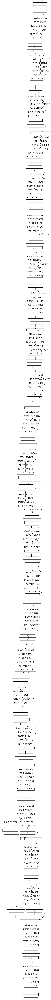

In [ ]:
plot_model(model3, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

# **Use the final model for inference**

In [ ]:
final_model=keras.models.load_model("/content/drive/MyDrive/Kang/final_model_comb.h5")

**make sure to add your correct image location in photo_filename variable below**

In [ ]:
import tensorflow as tf
from numpy import expand_dims
from keras.models import load_model
from keras.utils import load_img,img_to_array

# load and prepare an image
def load_image_pixels(filename, shape):
    # load the image to get its shape
    image = load_img(filename)
    width, height = image.size
    # load the image with the required size
    image = load_img(filename, target_size=shape)
    # convert to numpy array
    image = img_to_array(image)
    # scale pixel values to [0, 1]
    image = image.astype('float32')
    image /= 255.0
    # add a dimension so that we have one sample
    image = expand_dims(image, 0)
    return image, width, height


# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/mult2.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 2s 2s/step
[(1, 13, 13, 258), (1, 26, 26, 258), (1, 52, 52, 258)]


In [ ]:
import numpy as np

person 99.85218048095703
dog 91.32136702537537
kangaroo 89.7352933883667


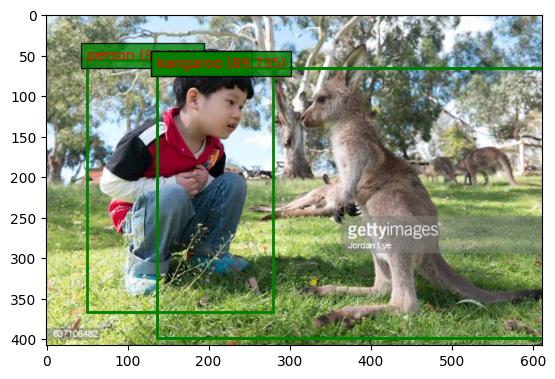

In [ ]:
# load yolov3 model and perform object detection
# based on https://github.com/experiencor/keras-yolo3
import numpy as np
from numpy import expand_dims
from keras.models import load_model
from keras.utils import load_img,img_to_array
from matplotlib import pyplot
from matplotlib.patches import Rectangle

class BoundBox:
	def __init__(self, xmin, ymin, xmax, ymax, objness = None, classes = None):
		self.xmin = xmin
		self.ymin = ymin
		self.xmax = xmax
		self.ymax = ymax
		self.objness = objness
		self.classes = classes
		self.label = -1
		self.score = -1

	def get_label(self):
		if self.label == -1:
			self.label = np.argmax(self.classes)

		return self.label

	def get_score(self):
		if self.score == -1:
			self.score = self.classes[self.get_label()]

		return self.score

def _sigmoid(x):
	return 1. / (1. + np.exp(-x))

def decode_netout(netout, anchors, obj_thresh, net_h, net_w):
	grid_h, grid_w = netout.shape[:2]
	nb_box = 3
	netout = netout.reshape((grid_h, grid_w, nb_box, -1))
	nb_class = netout.shape[-1] - 5
	boxes = []
	netout[..., :2]  = _sigmoid(netout[..., :2])
	netout[..., 4:]  = _sigmoid(netout[..., 4:])
	netout[..., 5:]  = netout[..., 4][..., np.newaxis] * netout[..., 5:]
	netout[..., 5:] *= netout[..., 5:] > obj_thresh

	for i in range(grid_h*grid_w):
		row = i / grid_w
		col = i % grid_w
		for b in range(nb_box):
			# 4th element is objectness score
			objectness = netout[int(row)][int(col)][b][4]
			if(objectness.all() <= obj_thresh): continue
			# first 4 elements are x, y, w, and h
			x, y, w, h = netout[int(row)][int(col)][b][:4]
			x = (col + x) / grid_w # center position, unit: image width
			y = (row + y) / grid_h # center position, unit: image height
			w = anchors[2 * b + 0] * np.exp(w) / net_w # unit: image width
			h = anchors[2 * b + 1] * np.exp(h) / net_h # unit: image height
			# last elements are class probabilities
			classes = netout[int(row)][col][b][5:]
			box = BoundBox(x-w/2, y-h/2, x+w/2, y+h/2, objectness, classes)
			boxes.append(box)
	return boxes

def correct_yolo_boxes(boxes, image_h, image_w, net_h, net_w):
	new_w, new_h = net_w, net_h
	for i in range(len(boxes)):
		x_offset, x_scale = (net_w - new_w)/2./net_w, float(new_w)/net_w
		y_offset, y_scale = (net_h - new_h)/2./net_h, float(new_h)/net_h
		boxes[i].xmin = int((boxes[i].xmin - x_offset) / x_scale * image_w)
		boxes[i].xmax = int((boxes[i].xmax - x_offset) / x_scale * image_w)
		boxes[i].ymin = int((boxes[i].ymin - y_offset) / y_scale * image_h)
		boxes[i].ymax = int((boxes[i].ymax - y_offset) / y_scale * image_h)

def _interval_overlap(interval_a, interval_b):
	x1, x2 = interval_a
	x3, x4 = interval_b
	if x3 < x1:
		if x4 < x1:
			return 0
		else:
			return min(x2,x4) - x1
	else:
		if x2 < x3:
			return 0
		else:
			 return min(x2,x4) - x3

def bbox_iou(box1, box2):
	intersect_w = _interval_overlap([box1.xmin, box1.xmax], [box2.xmin, box2.xmax])
	intersect_h = _interval_overlap([box1.ymin, box1.ymax], [box2.ymin, box2.ymax])
	intersect = intersect_w * intersect_h
	w1, h1 = box1.xmax-box1.xmin, box1.ymax-box1.ymin
	w2, h2 = box2.xmax-box2.xmin, box2.ymax-box2.ymin
	union = w1*h1 + w2*h2 - intersect
	return float(intersect) / union

def do_nms(boxes, nms_thresh):
	if len(boxes) > 0:
		nb_class = len(boxes[0].classes)
	else:
		return
	for c in range(nb_class):
		sorted_indices = np.argsort([-box.classes[c] for box in boxes])
		for i in range(len(sorted_indices)):
			index_i = sorted_indices[i]
			if boxes[index_i].classes[c] == 0: continue
			for j in range(i+1, len(sorted_indices)):
				index_j = sorted_indices[j]
				if bbox_iou(boxes[index_i], boxes[index_j]) >= nms_thresh:
					boxes[index_j].classes[c] = 0

# load and prepare an image
def load_image_pixels(filename, shape):
	# load the image to get its shape
	image = load_img(filename)
	width, height = image.size
	# load the image with the required size
	image = load_img(filename, target_size=shape)
	# convert to numpy array
	image = img_to_array(image)
	# scale pixel values to [0, 1]
	image = image.astype('float32')
	image /= 255.0
	# add a dimension so that we have one sample
	image = expand_dims(image, 0)
	return image, width, height

# # get all of the results above a threshold
# def get_boxes(boxes, labels, thresh):
# 	v_boxes, v_labels, v_scores = list(), list(), list()
# 	# enumerate all boxes
# 	for box in boxes:
# 		# enumerate all possible labels
# 		temp1=[]
# 		temp2=[]
# 		temp3=[]
# 		for i in range(len(labels)):
# 				# check if the threshold for this label is high enough
# 			if box.classes[i]>thresh:
# 				if len(temp3)>0:
# 					if temp3[0]<box.classes[i]*100:
# 						temp1[0]=box
# 						temp2[0]=labels[i]
# 						temp3[0]=box.classes[i]*100
# 				else:
# 					temp1.append(box)
# 					temp2.append(labels[i])
# 					temp3.append(box.classes[i]*100)

# 		if(len(temp1)>0):
# 			v_boxes.append(temp1[0])
# 			v_labels.append(temp2[0])
# 			v_scores.append(temp3[0])
# 					# don't break, many labels may trigger for one box
# 	return v_boxes, v_labels, v_scores

def get_boxes(boxes, labels, thresh):
	v_boxes, v_labels, v_scores = list(), list(), list()
	# enumerate all boxes
	for box in boxes:
		# enumerate all possible labels
		for i in range(len(labels)):
			# check if the threshold for this label is high enough
			if box.classes[i] > thresh:
				v_boxes.append(box)
				v_labels.append(labels[i])
				v_scores.append(box.classes[i]*100)
				# don't break, many labels may trigger for one box
	return v_boxes, v_labels, v_scores

# draw all results
def draw_boxes(filename, v_boxes, v_labels, v_scores):
	# load the image
	data = pyplot.imread(filename)
	# plot the image
	pyplot.imshow(data)
	# get the context for drawing boxes
	ax = pyplot.gca()
	# plot each box
	for i in range(len(v_boxes)):
		box = v_boxes[i]
		# get coordinates
		y1, x1, y2, x2 = box.ymin, box.xmin, box.ymax, box.xmax
		# calculate width and height of the box
		width, height = x2 - x1, y2 - y1
		# create the shape
		rect = Rectangle((x1, y1), width, height, fill=False, color='green', linewidth=2)
		# draw the box
		ax.add_patch(rect)
		# draw text and score in top left corner
		label = "%s (%.3f)" % (v_labels[i], v_scores[i])
		pyplot.text(x1, y1, label, color='red', bbox=dict(facecolor='green', alpha=0.8))
	# show the plot
	pyplot.show()


anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.5
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# define the labels
labels = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck",
	"boat", "traffic light", "fire hydrant", "stop sign", "parking meter", "bench",
	"bird", "cat", "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe",
	"backpack", "umbrella", "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard",
	"sports ball", "kite", "baseball bat", "baseball glove", "skateboard", "surfboard",
	"tennis racket", "bottle", "wine glass", "cup", "fork", "knife", "spoon", "bowl", "banana",
	"apple", "sandwich", "orange", "broccoli", "carrot", "hot dog", "pizza", "donut", "cake",
	"chair", "sofa", "pottedplant", "bed", "diningtable", "toilet", "tvmonitor", "laptop", "mouse",
	"remote", "keyboard", "cell phone", "microwave", "oven", "toaster", "sink", "refrigerator",
	"book", "clock", "vase", "scissors", "teddy bear", "hair drier", "toothbrush","kangaroo"]
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [ ]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/kang3.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 0s 41ms/step
[(1, 13, 13, 258), (1, 26, 26, 258), (1, 52, 52, 258)]


kangaroo 92.495858669281
dog 71.79287075996399


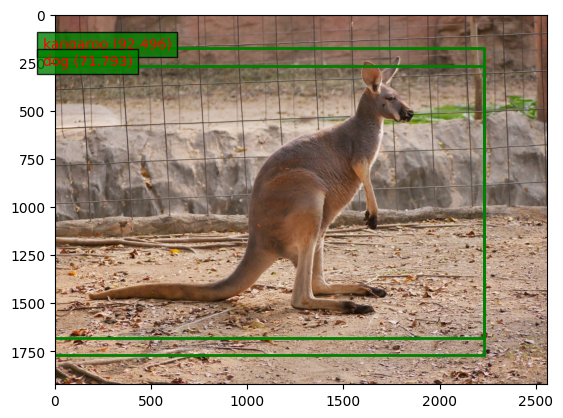

In [ ]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [ ]:
%cd /content

/content


In [ ]:
!wget https://i.pinimg.com/originals/0e/4d/ed/0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg

--2023-07-06 13:04:31--  https://i.pinimg.com/originals/0e/4d/ed/0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg
Resolving i.pinimg.com (i.pinimg.com)... 23.33.29.144, 23.33.29.136, 2600:1407:3c00:44::17dc:905a, ...
Connecting to i.pinimg.com (i.pinimg.com)|23.33.29.144|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 35599 (35K) [image/jpeg]
Saving to: ‘0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg’

0e4ded12fcd6fb8a894 100%[===================>]  34.76K  --.-KB/s    in 0.01s   

2023-07-06 13:04:32 (3.02 MB/s) - ‘0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg’ saved [35599/35599]



In [ ]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 0s 29ms/step
[(1, 13, 13, 258), (1, 26, 26, 258), (1, 52, 52, 258)]


kangaroo 94.79489326477051
bicycle 98.93931150436401


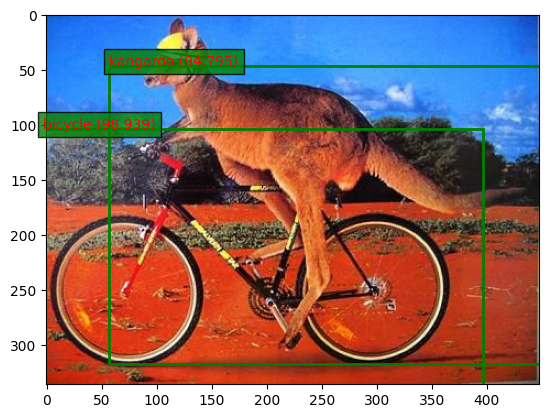

In [ ]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [ ]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/mult3.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 0s 29ms/step
[(1, 13, 13, 258), (1, 26, 26, 258), (1, 52, 52, 258)]


person 99.94537234306335
bicycle 99.4314432144165


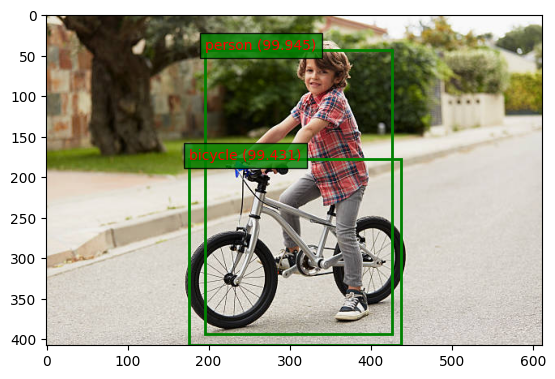

In [ ]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [ ]:
!wget https://cdn.pixabay.com/photo/2012/05/29/00/43/car-49278_640.jpg

--2023-07-06 13:07:11--  https://cdn.pixabay.com/photo/2012/05/29/00/43/car-49278_640.jpg
Resolving cdn.pixabay.com (cdn.pixabay.com)... 104.18.14.16, 104.18.15.16, 2606:4700::6812:f10, ...
Connecting to cdn.pixabay.com (cdn.pixabay.com)|104.18.14.16|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 16045 (16K) [image/jpeg]
Saving to: ‘car-49278_640.jpg’

car-49278_640.jpg   100%[===================>]  15.67K  --.-KB/s    in 0s      

2023-07-06 13:07:11 (84.9 MB/s) - ‘car-49278_640.jpg’ saved [16045/16045]



In [ ]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/car-49278_640.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 0s 31ms/step
[(1, 13, 13, 258), (1, 26, 26, 258), (1, 52, 52, 258)]


car 97.84097671508789
car 96.01274728775024


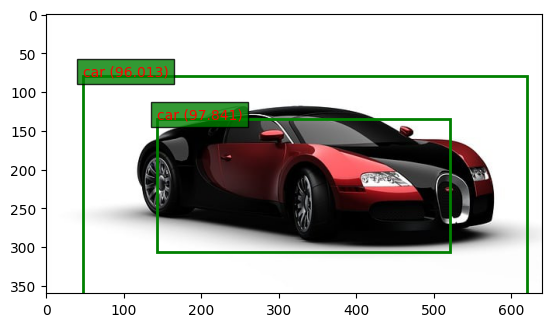

In [ ]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [ ]:
!wget https://s.wsj.net/public/resources/images/BN-LG733_AUSROO_M_20151115174635.jpg

--2023-07-06 13:08:25--  https://s.wsj.net/public/resources/images/BN-LG733_AUSROO_M_20151115174635.jpg
Resolving s.wsj.net (s.wsj.net)... 99.84.160.43, 99.84.160.122, 99.84.160.41, ...
Connecting to s.wsj.net (s.wsj.net)|99.84.160.43|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 127596 (125K) [image/jpeg]
Saving to: ‘BN-LG733_AUSROO_M_20151115174635.jpg’

BN-LG733_AUSROO_M_2 100%[===================>] 124.61K  --.-KB/s    in 0.02s   

2023-07-06 13:08:26 (5.14 MB/s) - ‘BN-LG733_AUSROO_M_20151115174635.jpg’ saved [127596/127596]



In [ ]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/BN-LG733_AUSROO_M_20151115174635.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 0s 72ms/step
[(1, 13, 13, 258), (1, 26, 26, 258), (1, 52, 52, 258)]


car 99.86537098884583
cat 96.16342186927795
kangaroo 91.33438467979431


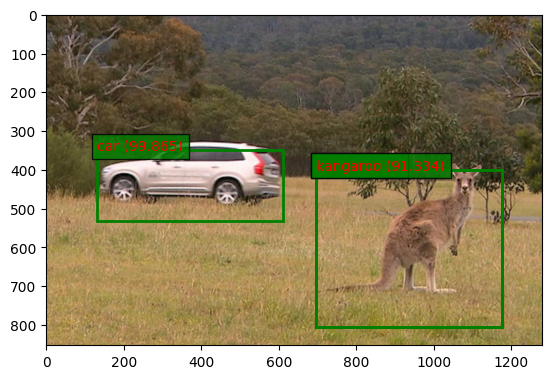

In [ ]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

we have used small amount of images from COCO because it was seen that if we dont , the model's weights adjust such that for every object it detects it will give right class prediction as well as tell its kangaroo . so to avoid this **false prediction** we have added the small amount of coco dataset images mixed with our new class .

Since pre trained Yolov3 detects kangaroo but classifys it as dog since COCO does not have kangaroo class , even in the extended model other than kangaroo it might sometimes say its a dog , this can be avoided by taking the best score prediction (here we are showing all the class predictions which cross the threshold) .

Detailed report is in the word document